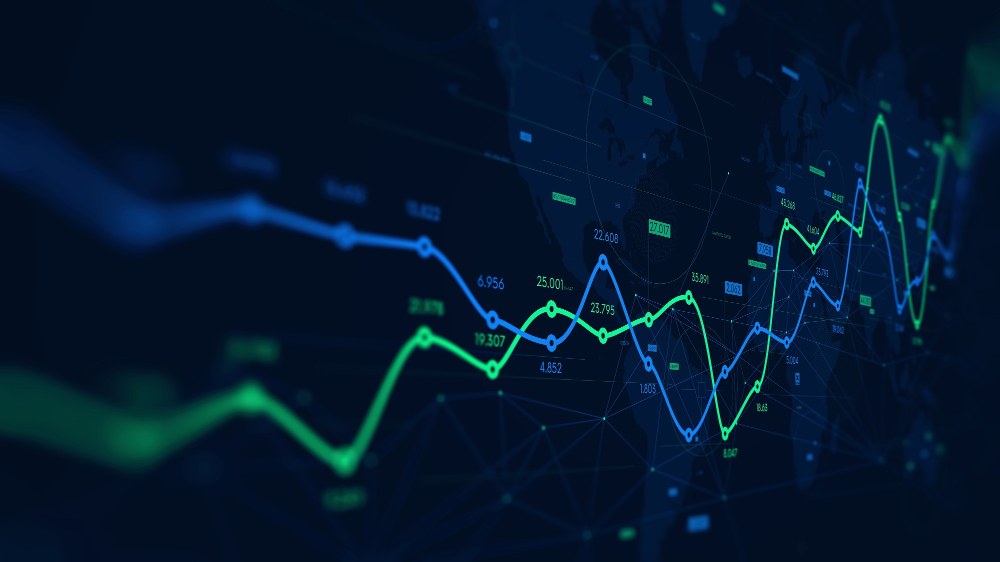







---
# Stock Performance and Fundamentals Dashboard

This Notebook provides an interactive dashboard for analyzing the performance and fundamental metrics of a given stock. By entering a ticker symbol, the notebook retrieves historical stock data and computes key statistics, such as returns over different periods and fundamental metrics like market capitalization, P/E ratio, and EPS. The notebook plots the stock's closing price over time and displays the calculated statistics in a well-formatted manner.

## Features

- **Interactive Ticker Input:** Enter any valid stock ticker symbol to fetch the latest data.
- **Historical Price Chart:** Plots the closing price of the stock over the last two years.
- **Return Statistics:** Calculates and displays the 1-month, 1-year, and 2-year returns.
- **Fundamental Metrics:** Displays the market capitalization, P/E ratio, and EPS.
- **Highlight Pandemics:** Optionally highlights periods of significant market events, such as the COVID-19 pandemic, to show fluctuations.

## Requirements

- `matplotlib`
- `pandas`
- `yfinance`

## How to Use

1. Install the required libraries using pip:
    ```bash
    pip install matplotlib pandas yfinance
    ```
2. Run the notebook and enter a ticker symbol when prompted.
3. View the generated charts and statistics for the entered stock.


# Libs


In [1]:
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
from datetime import datetime, timedelta
import yfinance as yf
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

In [2]:
# To increase the limit for embedding larger animations in Matplotlib, you can
# adjust the animation.embed_limit parameter.
plt.rcParams['animation.embed_limit'] = 256  # Adjust the limit as needed (in MB)


# Customized theme.

For different themes, adjust the parameters as needed

```
# Adjust matplotlib style settings for dark background with green lines
plt.style.use('dark_background')
plt.rcParams['axes.grid'] = True
plt.rcParams['grid.color'] = 'gray'
plt.rcParams['lines.linewidth'] = 2.5
plt.rcParams['lines.color'] = 'green'
```



# Nasdaq Example

In [ ]:
# Obtain yesterday's date
yesterday = datetime.today() - timedelta(days=1)

# Obtain NASDAQ data
nasdaq = yf.download('^IXIC', start='2018-01-01', end=yesterday)

# Resample the DataFrame to a weekly interval and forward-fill missing values
nasdaq_weekly = nasdaq.resample('W').last().ffill()

# Reset the index and create a new 'Date' column
nasdaq_weekly = nasdaq_weekly.reset_index()

# Sort the DataFrame by the 'Date' column in ascending order
nasdaq_sorted = nasdaq_weekly.sort_values('Date')


nasdaq_sorted.head()

[*********************100%%**********************]  1 of 1 completed


,Date,Open,High,Low,Close,Adj Close,Volume
0,2018-01-07,7105.740234,7137.040039,7097.080078,7136.560059,7136.560059,2024000000
1,2018-01-14,7208.169922,7265.259766,7205.180176,7261.060059,7261.060059,1986600000
2,2018-01-21,7312.000000,7336.379883,7297.279785,7336.379883,7336.379883,2005470000
3,2018-01-28,7448.330078,7505.770020,7431.220215,7505.770020,7505.770020,2080700000
4,2018-02-04,7347.589844,7364.430176,7238.180176,7240.950195,7240.950195,2607160000


 - in here, you can upload a image/logo.
 In this code I used linkedin.png as an example.

[*********************100%%**********************]  1 of 1 completed


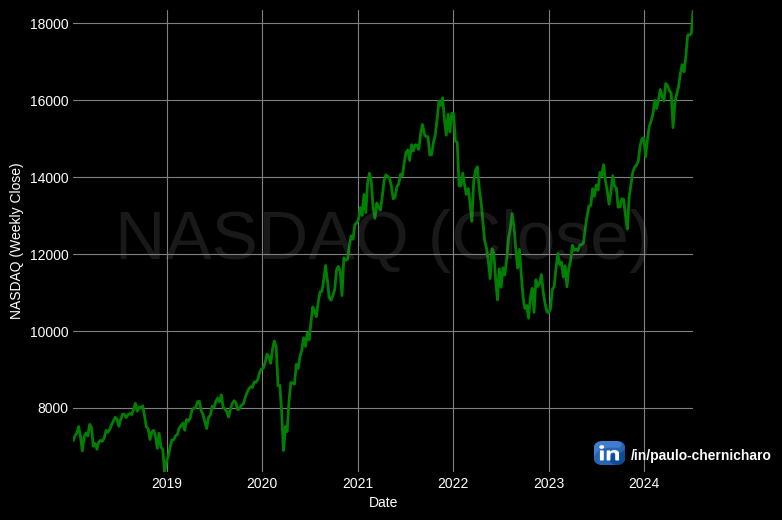

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
from datetime import datetime, timedelta
import yfinance as yf

# Adjust matplotlib style settings for dark background with green lines
plt.style.use('dark_background')
plt.rcParams['axes.grid'] = True
plt.rcParams['grid.color'] = 'gray'
plt.rcParams['lines.linewidth'] = 2.5
plt.rcParams['lines.color'] = 'green'

# Obtain yesterday's date
yesterday = datetime.today() - timedelta(days=1)

# Obtain NASDAQ data
nasdaq = yf.download('^IXIC', start='2018-01-01', end=yesterday)

# Resample the DataFrame to a weekly interval and forward-fill missing values
nasdaq_weekly = nasdaq.resample('W').last().ffill()

# Reset the index and create a new 'Date' column
nasdaq_weekly = nasdaq_weekly.reset_index()

# Sort the DataFrame by the 'Date' column in ascending order
nasdaq_sorted = nasdaq_weekly.sort_values('Date')

# Set up the figure and axes
fig, ax = plt.subplots(figsize=(8, 6))

# Initialize an empty line plot
line, = ax.plot([], [], lw=2, color='green')  # Use green color for the series line

# Set the x and y limits for the plot
ax.set_xlim(nasdaq_sorted['Date'].min(), nasdaq_sorted['Date'].max())
ax.set_ylim(nasdaq_sorted['Close'].min(), nasdaq_sorted['Close'].max())

# Set the x-axis label
ax.set_xlabel('Date', color='white')  # Set x-axis label color to white

# Set the y-axis label
ax.set_ylabel('NASDAQ (Weekly Close)', color='white')  # Set y-axis label color to white

# Add LinkedIn logo image annotation
linkedin_logo = plt.imread('linkedin_logo.png')  # Replace 'linkedin_logo.png' with your LinkedIn logo image path
logo_size = 0.05  # Adjust size of the logo relative to the axes
ax.imshow(linkedin_logo, aspect='auto', extent=(0.9 - logo_size * 1.2, 0.9 - logo_size * 0.2, 0.015, 0.065), transform=ax.transAxes)

# Add your name annotation (bold)
ax.text(0.9, 0.02, '/in/paulo-chernicharo', fontsize=10, color='white', weight='bold', ha='left', va='bottom', transform=ax.transAxes)

# Define the update function for the animation
def update(frame):
    # Get the data up to the current frame
    data = nasdaq_sorted.iloc[:frame + 1]

    # Update the line plot with the new data
    line.set_data(data['Date'], data['Close'])

    return line,

# Create the animation
ani = animation.FuncAnimation(fig, update, frames=len(nasdaq_sorted), interval=30, blit=True)

# Convert the animation to HTML
html_ani = ani.to_jshtml()

# Display the animated chart
HTML(html_ani)


# Download plot


## Save as GIF sample

In [ ]:
# Save the animation as a GIF file
ani.save('animation.gif', writer='imagemagick', fps=30)

# Optionally, download the GIF file (for Google Colab)
from google.colab import files
files.download('animation.gif')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

## Saves as mp4


In [ ]:
# Save the animation as an MP4 file
ani.save('animation.mp4', writer='ffmpeg', fps=30)

# Download the MP4 file
from google.colab import files
files.download('animation.mp4')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

# Stats dashboard.

In this design, the plot features return info as well as some fundamentals.


In [ ]:
# Adjust matplotlib style settings for dark background with green lines
plt.style.use('dark_background')
plt.rcParams['axes.grid'] = True
plt.rcParams['grid.color'] = 'gray'
plt.rcParams['lines.linewidth'] = 2.5
plt.rcParams['lines.color'] = 'green'

#User inputs a ticker

- User inputs a stock
- Plot: Displays a weekly resample plot (can be adjusted to other periods).
- Highlights a given period.

Enter a ticker symbol (e.g., AAPL for Apple): NVDA


[*********************100%%**********************]  1 of 1 completed


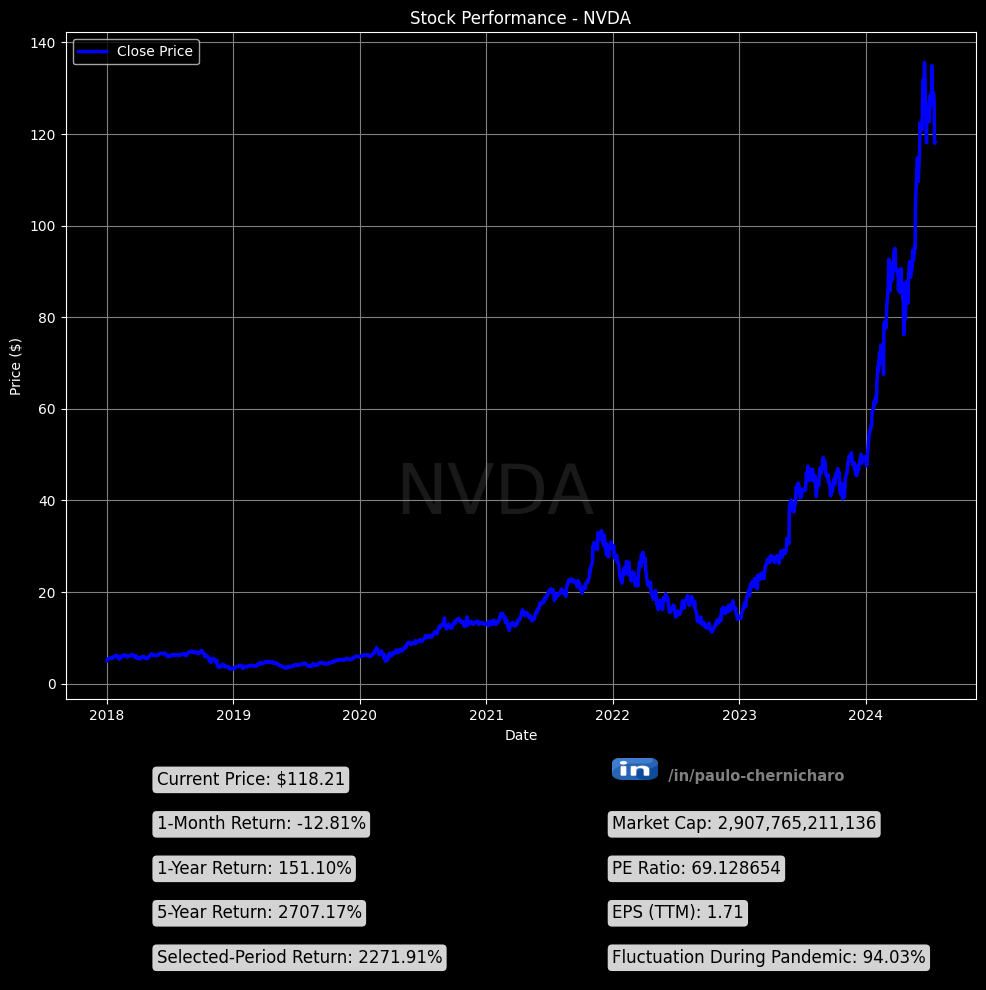

In [149]:
import matplotlib.pyplot as plt
from datetime import datetime, timedelta
import yfinance as yf
import pandas as pd
import numpy as np

# Obtain user's input for ticker symbol
ticker = input("Enter a ticker symbol (e.g., AAPL for Apple): ")

# Obtain stock data
stock_data = yf.download(ticker, start='2018-01-01', end=datetime.today())

# Convert index to datetime if not already
stock_data.index = pd.to_datetime(stock_data.index)

# Calculate main statistics
total_return = (stock_data['Close'].iloc[-1] / stock_data['Close'].iloc[0]) - 1

# Ensure the dates exist within the data range
one_month_ago = stock_data.index[-1] - timedelta(days=30)
one_year_ago = stock_data.index[-1] - timedelta(days=365)
two_years_ago = stock_data.index[-1] - timedelta(days=2*365)
five_years_ago = stock_data.index[-1] - timedelta(days=5*365)

# Find the closest available date in the data
one_month_ago_index = np.argmin(np.abs(stock_data.index - one_month_ago))
one_year_ago_index = np.argmin(np.abs(stock_data.index - one_year_ago))
two_years_ago_index = np.argmin(np.abs(stock_data.index - two_years_ago))
five_years_ago_index = np.argmin(np.abs(stock_data.index - five_years_ago))

last_month_return = (stock_data['Close'].iloc[-1] / stock_data['Close'].iloc[one_month_ago_index]) - 1
one_year_return = (stock_data['Close'].iloc[-1] / stock_data['Close'].iloc[one_year_ago_index]) - 1
two_year_return = (stock_data['Close'].iloc[-1] / stock_data['Close'].iloc[two_years_ago_index]) - 1
five_year_return = (stock_data['Close'].iloc[-1] / stock_data['Close'].iloc[five_years_ago_index]) - 1

# Define the pandemic announcement period
pandemic_start = '2020-01-01'
pandemic_end = '2020-06-30'
pandemic_period = stock_data[pandemic_start:pandemic_end]
pandemic_fluctuation = (pandemic_period['Close'].max() / pandemic_period['Close'].min()) - 1

# Obtain fundamental data
stock_info = yf.Ticker(ticker).info
market_cap = stock_info.get('marketCap', 'N/A')
pe_ratio = stock_info.get('trailingPE', 'N/A')
eps = stock_info.get('trailingEps', 'N/A')

# Set up the figure and axes
fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(10, 10), gridspec_kw={'height_ratios': [3, 1]})

# Set the background color and opacity for the title watermark
fig.text(0.5, 0.5, ticker, color='gray', fontsize=50, alpha=0.2,
         ha='center', va='center', rotation=0, transform=fig.transFigure)

# Plot the stock data
ax1.plot(stock_data['Close'], label='Close Price', color='blue')
ax1.set_title(f'Stock Performance - {ticker}')
ax1.set_xlabel('Date')
ax1.set_ylabel('Price ($)')
ax1.legend()

# Add LinkedIn logo image annotation to ax2 (bottom panel)
linkedin_logo = plt.imread('linkedin_logo.png')  # Replace 'linkedin_logo.png' with your LinkedIn logo image path
logo_size = 0.05  # Adjust size of the logo relative to the axes

# Center the logo horizontally and position it higher vertically
extent_left = 0.6  # Adjust this value to center horizontally
extent_top = 0.9  # Adjust this value to move higher vertically

ax2.imshow(linkedin_logo, aspect='auto', extent=(extent_left, extent_left + logo_size, extent_top, extent_top + logo_size * 2), transform=ax2.transAxes)
ax2.axis('off')

# Add your LinkedIn profile address text beside the logo
ax2.text(extent_left + logo_size * 1.0, extent_top + logo_size, '  /in/paulo-chernicharo', fontsize=10.5, weight ='bold', color='gray',
         ha='left', va='top', transform=ax2.transAxes)


# Display main statistics
ax2.axis('off')

# Define button properties
button_props = dict(boxstyle="round,pad=0.3", edgecolor="black", facecolor="lightgray")

# Display statistics
ax2.text(0.1, 0.9, f"Current Price: ${stock_data['Close'].iloc[-1]:.2f}", transform=ax2.transAxes, fontsize=12,
         verticalalignment='center', horizontalalignment='left', bbox=button_props, color='black')

ax2.text(0.1, 0.7, f"1-Month Return: {last_month_return:.2%}", transform=ax2.transAxes, fontsize=12,
         verticalalignment='center', horizontalalignment='left', bbox=button_props, color='black')

ax2.text(0.1, 0.5, f"1-Year Return: {one_year_return:.2%}", transform=ax2.transAxes, fontsize=12,
         verticalalignment='center', horizontalalignment='left', bbox=button_props, color='black')

ax2.text(0.1, 0.3, f"2-Year Return: {two_year_return:.2%}", transform=ax2.transAxes, fontsize=12,
         verticalalignment='center', horizontalalignment='left', bbox=button_props, color='black')

ax2.text(0.1, 0.3, f"5-Year Return: {five_year_return:.2%}", transform=ax2.transAxes, fontsize=12,
         verticalalignment='center', horizontalalignment='left', bbox=button_props, color='black')

ax2.text(0.1, 0.1, f"Selected-Period Return: {total_return:.2%}", transform=ax2.transAxes, fontsize=12,
         verticalalignment='center', horizontalalignment='left', bbox=button_props, color='black')

ax2.text(0.6, 0.7, f"Market Cap: {market_cap:,}", transform=ax2.transAxes, fontsize=12,
         verticalalignment='center', horizontalalignment='left', bbox=button_props, color='black')

ax2.text(0.6, 0.5, f"PE Ratio: {pe_ratio}", transform=ax2.transAxes, fontsize=12,
         verticalalignment='center', horizontalalignment='left', bbox=button_props, color='black')

ax2.text(0.6, 0.3, f"EPS (TTM): {eps}", transform=ax2.transAxes, fontsize=12,
         verticalalignment='center', horizontalalignment='left', bbox=button_props, color='black')

ax2.text(0.6, 0.1, f"Fluctuation During Pandemic: {pandemic_fluctuation:.2%}", transform=ax2.transAxes, fontsize=12,
         verticalalignment='center', horizontalalignment='left', bbox=button_props, color='black')

# Show the plot
plt.tight_layout()
plt.show()
